# Enhancing E-Commerce Strategies Through Customer Behavior Analysis
<span style="font-size:20px;">\- Amisha Kelkar, Arundhati(Ari) Kolahal, Chaitali Deshmukh, Neha Shastri

## Data Cleaning and Preparation

### Importing relevant libraries

In [1]:
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from joblib import Parallel, delayed
!pip install mlxtend
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from mlxtend.preprocessing import TransactionEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
!pip install psynlig
from matplotlib import pyplot as plt
from psynlig import (pca_explained_variance, pca_explained_variance_bar)
import plotly.express as px
import plotly.graph_objects as go
from sklearn.cluster import KMeans


### Loading the Dataset

In [2]:
events = pd.read_csv('events.csv')
events.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2756101 entries, 0 to 2756100
Data columns (total 5 columns):
 #   Column         Non-Null Count    Dtype  
---  ------         --------------    -----  
 0   timestamp      2756101 non-null  int64  
 1   visitorid      2756101 non-null  int64  
 2   event          2756101 non-null  object 
 3   itemid         2756101 non-null  int64  
 4   transactionid  22457 non-null    float64
dtypes: float64(1), int64(3), object(1)
memory usage: 105.1+ MB


### Preprocessing Data and Feature Engineering

* The `timestamp` column in the events is converted to datetime from timestamp. 
* The number of events have been aggregated per user
* The number of unique items purchased by every visitor is counted.

In [3]:
#USE THIS

# Convert timestamp to datetime
events['timestamp'] = pd.to_datetime(events['timestamp'], unit='ms')

# Aggregate counts per visitor
event_counts = events.pivot_table(index='visitorid', columns='event', values='itemid', aggfunc='count', fill_value=0)
event_counts.columns = ['total_addtocart', 'total_transaction', 'total_view']

# Count unique items per visitor
unique_items = events.groupby('visitorid')['itemid'].nunique().reset_index(name='unique_items')

* The `compute_avg_time_diffs` computes time differnece in seconds between each of the event i.e. view, add_to_cart and transactions
* The `compute_avg_transaction_gap`  computes average time between transactions
* The `process_visitor_batch` processes the data in batches to run the above functions in order to compute the features calculaed in previous functions
* Since the `events` data is large, using the defined functions, the data is processed in batches of 10,000 visitors and results are concatenated to a final dataframe `final_df` which is saved in parquet format for future use. The parquet file was used subsequently due to computational complexity.

In [ ]:
#DO NOT RUN 

#I REPEAT. DO NOT RUN!!!!


# Function to compute time differences for event pairs
def compute_avg_time_diffs(ordered_events, event1, event2):
    timestamps_1 = ordered_events.loc[ordered_events['event'] == event1, 'timestamp'].values
    timestamps_2 = ordered_events.loc[ordered_events['event'] == event2, 'timestamp'].values
    
    # Match each event1 to the next occurring event2
    time_diffs = []
    i, j = 0, 0
    while i < len(timestamps_1) and j < len(timestamps_2):
        if timestamps_2[j] > timestamps_1[i]: 
            time_diffs.append(timestamps_2[j] - timestamps_1[i])
            i += 1
        j += 1  

    time_diffs = np.array(time_diffs) / 1e9  
    return np.mean(time_diffs) if len(time_diffs) > 0 else np.nan

# Function to compute time between transactions
def compute_avg_transaction_gap(ordered_transactions):
    if len(ordered_transactions) < 2:
        return np.nan

    time_diffs = np.diff(ordered_transactions) / 1e9  # Convert to seconds
    return np.mean(time_diffs) if len(time_diffs) > 0 else np.nan

# Process a batch of visitors
def process_visitor_batch(batch_id, visitor_ids):
    batch_results = []

    for visitor_id in visitor_ids:
        visitor_data = df[df['visitorid'] == visitor_id].sort_values(by='timestamp')  # To ensure correct event order
        
        avg_view_to_addcart = compute_avg_time_diffs(visitor_data, 'view', 'addtocart')
        avg_addcart_to_transaction = compute_avg_time_diffs(visitor_data, 'addtocart', 'transaction')

        transaction_times = visitor_data.loc[visitor_data['event'] == 'transaction', 'timestamp'].values
        avg_transaction_gap = compute_avg_transaction_gap(transaction_times)

        batch_results.append({
            'visitorid': visitor_id,
            'avg_time_view_to_addtocart': avg_view_to_addcart,
            'avg_time_addtocart_to_transaction': avg_addcart_to_transaction,
            'avg_time_between_transactions': avg_transaction_gap
        })

    # Save batch results as Parquet
    batch_filename = f'batch_results_{batch_id}.parquet'
    pd.DataFrame(batch_results).to_parquet(batch_filename)
    return batch_filename

# Load DataFrame and ensure timestamps are sorted
df = events.sort_values(by=['visitorid', 'timestamp'])  # Sort entire dataset once

# Split visitors into chunks
visitor_ids = df['visitorid'].unique()
chunk_size = 10_000
visitor_chunks = [visitor_ids[i:i + chunk_size] for i in range(0, len(visitor_ids), chunk_size)]

# Parallel processing
batch_files = Parallel(n_jobs=-1)(
    delayed(process_visitor_batch)(i, chunk) for i, chunk in enumerate(visitor_chunks)
)

# Combine all results
final_df = pd.concat([pd.read_parquet(file) for file in batch_files])

# Save final results
final_df.to_parquet("final_visitor_metrics.parquet")

print("Processing complete. Results saved in 'final_visitor_metrics.parquet'.")


In [4]:
final_df = pd.read_parquet("final_visitor_metrics.parquet")

* The week is extracted from the timestamp in the `events` dataset.
* The average interactions per user in a week been calculated.
* The average items per transaction for every user in a week has been calculated.

In [5]:
#USE THIS

# Compute frequency of interactions in a week
events['week'] = events['timestamp'].dt.to_period('W')

interaction_stats = (
    events.groupby('visitorid')
    .agg(total_interactions=('week', 'count'), unique_weeks=('week', 'nunique'))
    .assign(avg_interactions_per_week=lambda x: x['total_interactions'] / x['unique_weeks'])
    .reset_index()
)

# Average number of items per transaction
avg_items_per_transaction = events[events['event'] == 'transaction'].groupby('visitorid')['transactionid'].count().reset_index()
avg_items_per_transaction = avg_items_per_transaction.groupby('visitorid')['transactionid'].mean().reset_index(name='avg_items_per_transaction')

In [6]:
interaction_stats.head(3)

,visitorid,total_interactions,unique_weeks,avg_interactions_per_week
0,0,3,1,3.0
1,1,1,1,1.0
2,2,8,1,8.0


* In order to get more insight in the customer behaviour patterns, conditional probability of events have been calculated.
* The conditional probability of a user adding an item to the cart when an item was viewed has been calculated.
* The conditional probability of a user actually getting through with the transaction when an item has been added to cart has been calculated.

In [6]:
conditional_probs = events.groupby(['visitorid', 'itemid', 'event']).size().unstack(fill_value=0)

# Compute conditional probabilities
conditional_probs['p_addtocart_given_view'] = conditional_probs['addtocart'] / conditional_probs['view'].replace(0, 1)
conditional_probs['p_transaction_given_addtocart'] = conditional_probs['transaction'] / conditional_probs['addtocart'].replace(0, 1)
conditional_probs = conditional_probs.groupby('visitorid')[['p_addtocart_given_view', 'p_transaction_given_addtocart']].mean()

Probabilty should not be greater than 1. Therefore we are capping it at 1. 

In [8]:
# Filter rows where p_addtocart_given_view > 1
invalid_entries = conditional_probs[conditional_probs['p_addtocart_given_view'] > 1].reset_index()

# Display the first 3 rows
invalid_entries.head(3)

event,visitorid,itemid,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart
0,745,246164,2,0,1,2.0,0.0
1,918,222888,2,0,0,2.0,0.0
2,1399,136523,2,0,0,2.0,0.0


In [9]:
invalid_entries = conditional_probs[conditional_probs['p_transaction_given_addtocart'] > 1].reset_index()

# Display the first 3 rows
invalid_entries.head(3)

event,visitorid,itemid,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart
0,11248,409804,1,2,2,0.500000,2.0
1,29802,393809,1,2,2,0.500000,2.0
2,30374,107503,1,2,3,0.333333,2.0


In [7]:
# Cap probabilities at 1
conditional_probs['p_addtocart_given_view'] = conditional_probs['p_addtocart_given_view'].clip(upper=1)
conditional_probs['p_transaction_given_addtocart'] = conditional_probs['p_transaction_given_addtocart'].clip(upper=1)

* Combined all the features extracted from `events` to create a new dataframe `users` which has data at a user level instead of transaction-level as was the case previously in the `events` dataframe.
* Replaces the nulls to 0 and converted the `users` to parquet for subsequent use.

In [9]:
# Merge all computed features
users = event_counts.merge(unique_items, on='visitorid', how='left')\
                        .merge(final_df, on='visitorid', how='left')\
                        .merge(interaction_stats[['avg_interactions_per_week', 'visitorid']], on='visitorid', how='left')\
                        .merge(conditional_probs, on='visitorid', how='left')\
                        .merge(avg_items_per_transaction, on='visitorid', how='left')

users.to_parquet('users.parquet')
# Display the final DataFrame
print(users.head())

   visitorid  total_addtocart  total_transaction  total_view  unique_items  \
0          0                0                  0           3             3   
1          1                0                  0           1             1   
2          2                0                  0           8             4   
3          3                0                  0           1             1   
4          4                0                  0           1             1   

   avg_time_view_to_addtocart  avg_time_addtocart_to_transaction  \
0                         NaN                                NaN   
1                         NaN                                NaN   
2                         NaN                                NaN   
3                         NaN                                NaN   
4                         NaN                                NaN   

   avg_time_between_transactions  avg_interactions_per_week  \
0                            NaN                        3.0

In [13]:
users.head(3)

,visitorid,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
0,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN
1,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN
2,0,0,0,3,3,NaN,NaN,NaN,3.0,0,0,1,0.0,0.0,NaN


In [14]:
missing_values = users.isnull().sum()
print("Missing Values Summary:")
print(missing_values[missing_values > 0])

Missing Values Summary:
avg_time_view_to_addtocart           1943703
avg_time_addtocart_to_transaction    2036793
avg_time_between_transactions        2063633
avg_items_per_transaction            2033400
dtype: int64


In [10]:
users.fillna(0, inplace=True)

In [13]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1407580 entries, 0 to 1407579
Data columns (total 12 columns):
 #   Column                             Non-Null Count    Dtype  
---  ------                             --------------    -----  
 0   visitorid                          1407580 non-null  int64  
 1   total_addtocart                    1407580 non-null  int64  
 2   total_transaction                  1407580 non-null  int64  
 3   total_view                         1407580 non-null  int64  
 4   unique_items                       1407580 non-null  int64  
 5   avg_time_view_to_addtocart         1407580 non-null  float64
 6   avg_time_addtocart_to_transaction  1407580 non-null  float64
 7   avg_time_between_transactions      1407580 non-null  float64
 8   avg_interactions_per_week          1407580 non-null  float64
 9   p_addtocart_given_view             1407580 non-null  float64
 10  p_transaction_given_addtocart      1407580 non-null  float64
 11  avg_items_per_transactio

In [12]:
users.to_parquet('users.parquet')

# Exploratory Data Analysis (EDA)

Exploratory Data Analysis was undertaken for both dataframes, the original one and the one creaed with additional features:
1. events
2. users

## Events

**Distribution of User Events**<br>
The plot illustrates the distribution of user interactions on the platform, highlighting that the majority of events are product views, followed by a significantly smaller number of add-to-cart actions and transactions. This suggests a high browsing activity but a relatively low conversion rate

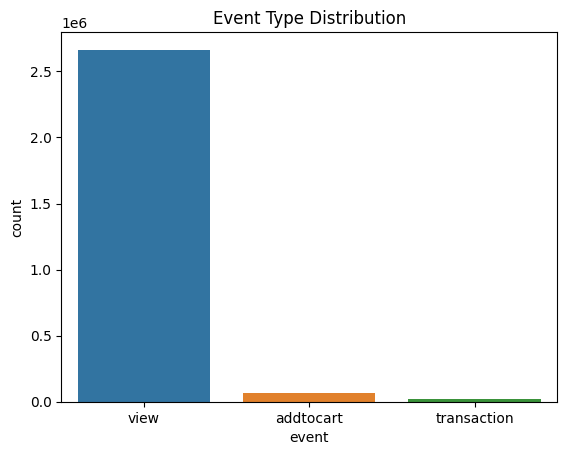

In [14]:
sns.countplot(x=events['event'])
plt.title("Event Type Distribution")
plt.show()

**Hourly Distribution of User Events**<br>
The graph shows the distribution of user events throughout the day, revealing two peak activity periods—one in the early hours (midnight to 5 AM) and another in the evening (around 4 PM to midnight). A noticeable drop in activity is observed between 6 AM and 2 PM, suggesting lower engagement during daytime hours.

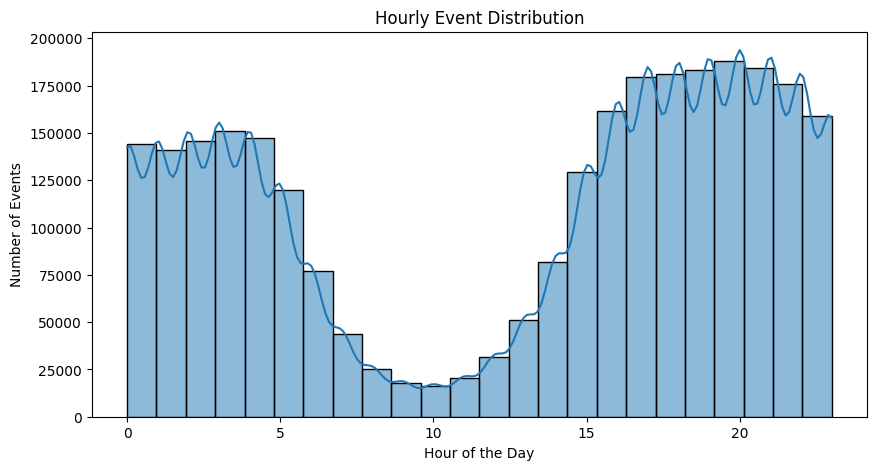

In [15]:
df = events.copy()
df['hour'] = events['timestamp'].dt.hour
df['day'] = events['timestamp'].dt.date

# Plot activity per hour
plt.figure(figsize=(10, 5))
sns.histplot(df['hour'], bins=24, kde=True)
plt.title("Hourly Event Distribution")
plt.xlabel("Hour of the Day")
plt.ylabel("Number of Events")
plt.show()

**Distribution of Unique Items per Transaction**<br>
The histogram visualizes the distribution of unique items purchased per transaction, showing that most transactions contain only one or two items, with the frequency rapidly declining as the number of unique items increases. The average number of unique items per transaction is 1.26, as indicated by the vertical dashed green line

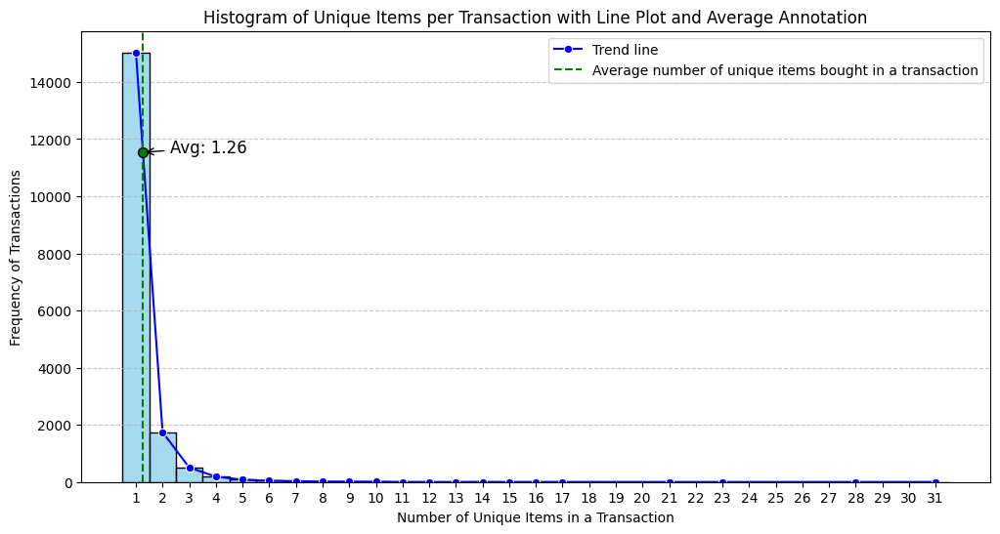

In [22]:

# Calculate the number of unique items per transaction
unique_items_per_transaction = events.groupby('transactionid')['itemid'].nunique()

# Count frequency of each unique item count
freq_counts = unique_items_per_transaction.value_counts().sort_index()

# Calculate average number of unique items per transaction
avg_unique_items = unique_items_per_transaction.mean()

# Create the plot
plt.figure(figsize=(12, 6))

# Histogram
sns.histplot(unique_items_per_transaction, bins=range(1, unique_items_per_transaction.max() + 2),
             kde=False, color='skyblue', discrete=True)

# Line plot overlay
sns.lineplot(x=freq_counts.index, y=freq_counts.values, marker='o', color='blue', label="Trend line")

# Highlight average with a vertical line
plt.axvline(avg_unique_items, color='green', linestyle='--', label='Average number of unique items bought in a transaction')

# Find corresponding y-value for annotation
avg_y_value = np.interp(avg_unique_items, freq_counts.index, freq_counts.values)

# Annotate the average point with an arrow
plt.scatter(avg_unique_items, avg_y_value, color='green', s=50, edgecolors='black', zorder=3)  # Smaller point
plt.annotate(f'Avg: {avg_unique_items:.2f}',
             xy=(avg_unique_items, avg_y_value),
             xytext=(avg_unique_items + 1, avg_y_value + 5),  # Offset text
             arrowprops=dict(facecolor='green', arrowstyle='->'),
             fontsize=12, color='black')

# Labels and title
plt.xlabel("Number of Unique Items in a Transaction")
plt.ylabel("Frequency of Transactions")
plt.title("Histogram of Unique Items per Transaction with Line Plot and Average Annotation")
plt.xticks(ticks=range(1, unique_items_per_transaction.max() + 1))  # Show all numbers on x-axis
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()



**Distribution of Transactions per Customer**<br>
The bar chart illustrates the distribution of customers based on the number of transactions they have made, showing that the majority of customers (nearly 12,000 in thousands) fall into the 1-5 transactions category. Very few customers make more than 5 transactions, indicating that repeat purchases are relatively rare.

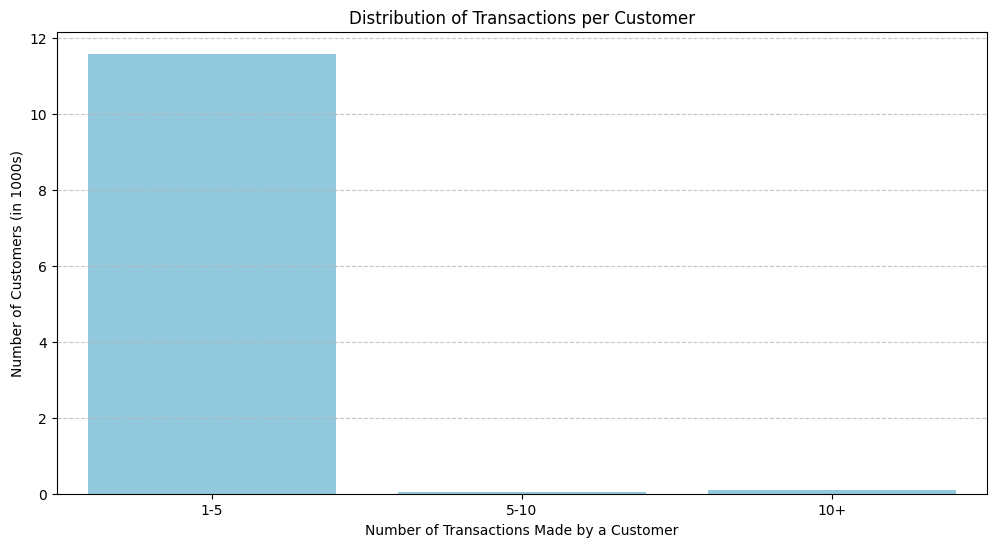

In [24]:


# Step 1: Calculate the number of transactions made by each customer
transactions_per_visitor = events.groupby('visitorid')['transactionid'].nunique()

# Step 2: Categorize the transactions into specific bins
def categorize_transactions(num):
    if num >= 10:
        return '10+'
    elif num >= 5:
        return '5-10'
    elif num >= 1:
        return '1-5'

# Apply the categorization
transaction_range = transactions_per_visitor.apply(categorize_transactions)

# Step 3: Count the number of customers in each transaction category
transaction_counts = transaction_range.value_counts().reindex(['1-5', '5-10', '10+'])

# Step 4: Plot the data
plt.figure(figsize=(12, 6))

# Bar chart for the number of customers in each transaction category
sns.barplot(x=transaction_counts.index,
            y=transaction_counts.values / 1000,  # Convert number of customers to thousands
            color='skyblue')

# Add labels and title
plt.xlabel("Number of Transactions Made by a Customer")
plt.ylabel("Number of Customers (in 1000s)")
plt.title("Distribution of Transactions per Customer")

# Show the legend and grid
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.show()


In [18]:
print(transactions_per_visitor.describe())

count    1.407580e+06
mean     1.255488e-02
std      6.839843e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      5.020000e+02
Name: transactionid, dtype: float64


**Pairwise Scatter Plot Matrix of Features**<br>
This scatter plot matrix visualizes the pairwise relationships between multiple numerical features in the dataset. Some feature pairs exhibit clear linear or clustered patterns, while others show weak or no correlation, indicating varying degrees of association across different attributes

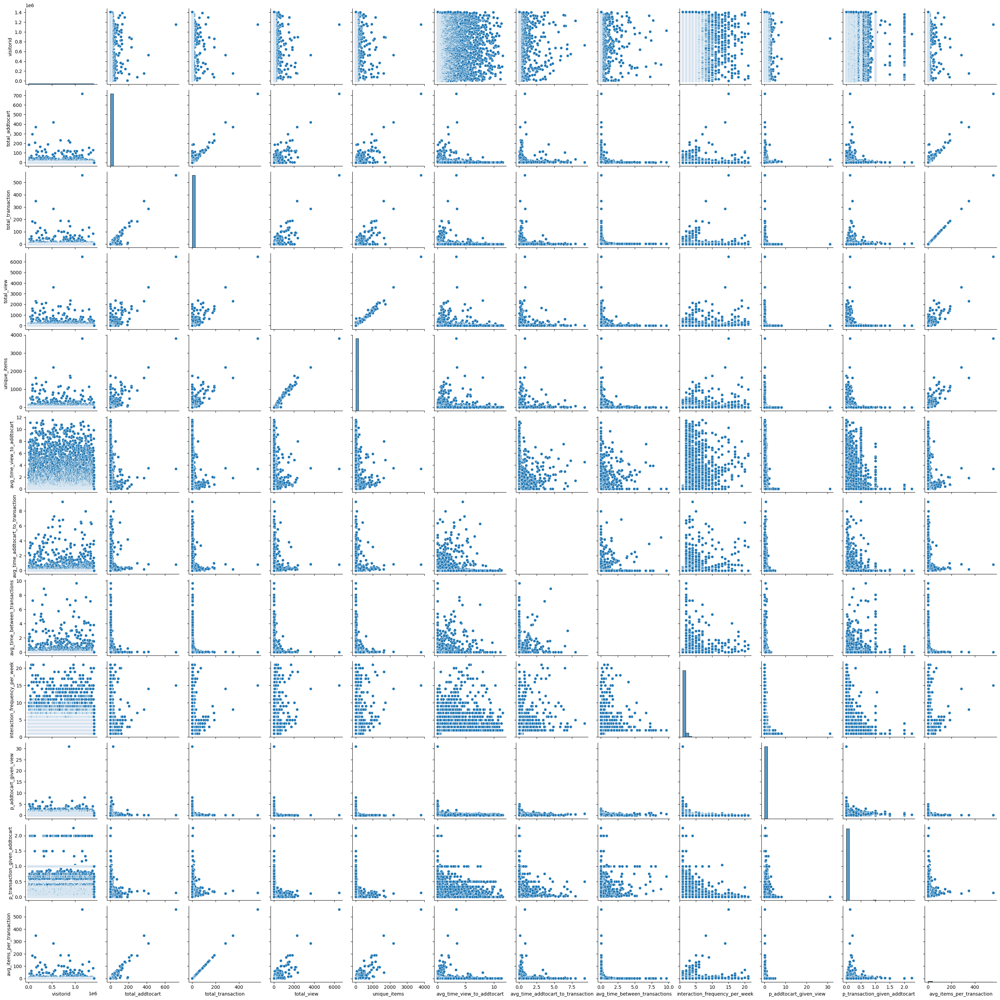

In [19]:
sns.pairplot(users)
plt.show()

# Market Basket Analysis

* Subsetted the dataset to visitors having more than 1 transaction in order to make the MArket BAsket Analysis more insightful

In [16]:
# Finding items that has more than 1 transaction

events_test = events[events['event'] == 'transaction']
events_items = events_test.groupby('itemid')['visitorid'].count()
events_items = events_items[events_items>1]
events_items = events_items.reset_index()
events_items.head()

,itemid,visitorid
0,25,2
1,147,4
2,496,2
3,546,23
4,829,5


In [17]:
# Subsetting the visitors from the original dataframe

mba_test = events[events["itemid"].isin(events_items["itemid"])]
mba_test = mba_test[mba_test['event'] == 'transaction']
mba_test.head()

,timestamp,visitorid,event,itemid,transactionid
130,1433222276276,599528,transaction,356475,4000.0
814,1433176736375,102019,transaction,150318,13556.0
1215,1433184261371,350566,transaction,284871,8796.0
1234,1433182772710,404403,transaction,150100,5216.0
1350,1433164275232,505565,transaction,243566,11713.0


* Created the item matrix i.e. the suitable format of the data to conduct MArket Basket Analysis

In [21]:
item_matrix = mba_test.pivot_table(index='itemid', columns='transactionid', 
                                 values='event', aggfunc=lambda x: 1, fill_value=0)
item_matrix.head(3)


transactionid,0.0,2.0,5.0,7.0,8.0,12.0,14.0,15.0,16.0,17.0,18.0,19.0,20.0,21.0,22.0,23.0,24.0,25.0,27.0,28.0,37.0,40.0,41.0,42.0,43.0,44.0,45.0,47.0,48.0,50.0,51.0,52.0,54.0,58.0,59.0,61.0,62.0,63.0,64.0,65.0,66.0,67.0,68.0,70.0,71.0,72.0,74.0,76.0,77.0,78.0,79.0,80.0,81.0,82.0,83.0,84.0,86.0,87.0,89.0,91.0,92.0,93.0,95.0,96.0,97.0,98.0,99.0,100.0,102.0,103.0,106.0,108.0,109.0,110.0,111.0,113.0,114.0,117.0,118.0,119.0,120.0,121.0,122.0,124.0,125.0,127.0,131.0,133.0,134.0,135.0,136.0,137.0,138.0,139.0,140.0,141.0,143.0,146.0,148.0,149.0,151.0,155.0,156.0,157.0,158.0,159.0,161.0,164.0,165.0,166.0,167.0,168.0,169.0,170.0,175.0,176.0,177.0,179.0,180.0,181.0,182.0,183.0,184.0,185.0,187.0,188.0,189.0,191.0,192.0,194.0,195.0,196.0,197.0,199.0,200.0,201.0,202.0,204.0,206.0,207.0,208.0,209.0,210.0,211.0,212.0,213.0,214.0,216.0,217.0,218.0,220.0,222.0,224.0,225.0,227.0,231.0,232.0,233.0,234.0,238.0,239.0,240.0,241.0,242.0,243.0,245.0,246.0,247.0,250.0,252.0,253.0,255.0,257.0,258.0,259.0,261.0,262.0,263.0,265.0,267.0,268.0,272.0,275.0,276.0,278.0,279.0,280.0,281.0,282.0,283.0,284.0,285.0,286.0,287.0,288.0,289.0,290.0,291.0,292.0,293.0,294.0,295.0,297.0,298.0,299.0,302.0,303.0,304.0,305.0,306.0,307.0,308.0,309.0,310.0,312.0,313.0,316.0,317.0,318.0,319.0,321.0,322.0,324.0,325.0,326.0,327.0,328.0,329.0,330.0,332.0,333.0,336.0,340.0,341.0,342.0,343.0,348.0,350.0,351.0,353.0,355.0,356.0,357.0,358.0,359.0,363.0,365.0,366.0,367.0,368.0,371.0,374.0,375.0,378.0,379.0,380.0,382.0,383.0,385.0,386.0,388.0,389.0,390.0,392.0,393.0,394.0,395.0,397.0,400.0,401.0,402.0,403.0,404.0,406.0,407.0,408.0,409.0,410.0,412.0,413.0,414.0,415.0,416.0,417.0,418.0,419.0,421.0,422.0,425.0,428.0,429.0,430.0,433.0,434.0,438.0,439.0,440.0,441.0,442.0,444.0,445.0,446.0,447.0,448.0,449.0,450.0,451.0,452.0,453.0,454.0,457.0,458.0,459.0,461.0,462.0,463.0,464.0,465.0,466.0,467.0,468.0,470.0,471.0,472.0,473.0,474.0,475.0,476.0,477.0,478.0,479.0,480.0,481.0,482.0,483.0,484.0,485.0,487.0,488.0,490.0,494.0,495.0,496.0,497.0,498.0,501.0,502.0,504.0,505.0,506.0,507.0,509.0,511.0,512.0,513.0,514.0,515.0,516.0,517.0,518.0,519.0,520.0,521.0,523.0,525.0,528.0,529.0,533.0,534.0,535.0,536.0,537.0,538.0,539.0,540.0,541.0,542.0,543.0,544.0,545.0,546.0,548.0,550.0,551.0,552.0,553.0,554.0,555.0,559.0,560.0,561.0,562.0,564.0,565.0,569.0,572.0,573.0,574.0,575.0,576.0,577.0,578.0,579.0,580.0,583.0,585.0,586.0,589.0,592.0,593.0,594.0,596.0,602.0,604.0,607.0,610.0,611.0,612.0,613.0,615.0,617.0,618.0,620.0,621.0,622.0,623.0,624.0,625.0,628.0,630.0,631.0,632.0,633.0,635.0,636.0,637.0,641.0,642.0,643.0,644.0,645.0,649.0,650.0,651.0,653.0,654.0,655.0,656.0,658.0,659.0,660.0,661.0,663.0,665.0,666.0,667.0,669.0,671.0,673.0,674.0,675.0,679.0,680.0,682.0,684.0,685.0,686.0,689.0,691.0,692.0,693.0,694.0,695.0,696.0,697.0,699.0,702.0,703.0,704.0,705.0,706.0,707.0,709.0,710.0,712.0,713.0,714.0,715.0,717.0,719.0,720.0,723.0,725.0,727.0,728.0,729.0,730.0,731.0,732.0,733.0,735.0,736.0,739.0,741.0,742.0,744.0,747.0,749.0,750.0,751.0,752.0,754.0,755.0,757.0,758.0,759.0,760.0,761.0,762.0,763.0,764.0,765.0,767.0,768.0,769.0,771.0,773.0,777.0,779.0,784.0,787.0,788.0,789.0,791.0,792.0,794.0,795.0,796.0,797.0,798.0,801.0,802.0,803.0,804.0,806.0,807.0,809.0,810.0,812.0,813.0,815.0,820.0,821.0,822.0,824.0,826.0,827.0,828.0,830.0,833.0,834.0,835.0,837.0,839.0,840.0,841.0,842.0,844.0,846.0,848.0,851.0,853.0,856.0,858.0,859.0,860.0,861.0,862.0,863.0,866.0,867.0,868.0,869.0,870.0,873.0,874.0,875.0,876.0,877.0,879.0,880.0,881.0,882.0,883.0,884.0,885.0,886.0,887.0,889.0,890.0,891.0,893.0,894.0,896.0,897.0,898.0,899.0,900.0,902.0,903.0,904.0,905.0,906.0,908.0,909.0,910.0,911.0,912.0,914.0,915.0,916.0,917.0,920.0,921.0,922.0,925.0,926.0,927.0,929.0,930.0,931.0,933.0,936.0,937.0,938.0,939.0,940.0,941.0,942.0,943.0,944.0,946.0,947.0,948.0,950.0,953.0,954.0,955.0,956.0,957.0,959.0,960.0,963.0,964.0,965.0,966.0,967.0,968.0,969.0,970.0,971.0,972.0,973.0,975.0,978.0,980.0,981.0,982.0,985.0,988.0,989.0,992.0,993.0,994.0,995.0,996.0,99

In [ ]:
# This approach is wrong approach because we are taking frequency of the item which can be 2 and that will lead to errors in the apriori stage 
item_matrix = events.pivot_table(index='itemid', columns='transactionid', aggfunc='size', fill_value=0)
item_matrix.head()

* To find the frequently bought itemsets with a support greater than 0.001

In [24]:
frequent_itemsets = apriori(item_matrix, min_support=0.001, use_colnames=True)
frequent_itemsets.sort_values(by="support").head()

#print('Itemsets with frequency>1:', frequent_itemsets[frequent_itemsets['itemsets'].apply(lambda x: len(x) > 1)].shape[0])

/opt/conda/lib/python3.10/site-packages/mlxtend/frequent_patterns/fpcommon.py:161: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


,support,itemsets
96,0.00116,"(7592.0, 10264.0, 11188.0)"
27,0.00116,(6704.0)
77,0.00116,(16851.0)
29,0.00116,(7047.0)
34,0.00116,(7691.0)


* To find the association rules having a confidence of greater than 0.5

In [23]:
rules = association_rules(frequent_itemsets,
                          num_itemsets=frequent_itemsets.shape[0],
                          metric="confidence", min_threshold=0.5)
rules

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
0,(765.0),(7063.0),0.006263,0.006495,0.006031,0.962963,148.261905,1.0,0.005990,26.824635,0.999515,0.896552,0.962721,0.945767
1,(7063.0),(765.0),0.006495,0.006263,0.006031,0.928571,148.261905,1.0,0.005990,13.912317,0.999749,0.896552,0.928121,0.945767
2,(15625.0),(2110.0),0.002552,0.002320,0.002088,0.818182,352.718182,1.0,0.002082,5.487242,0.999716,0.750000,0.817759,0.859091
3,(2110.0),(15625.0),0.002320,0.002552,0.002088,0.900000,352.718182,1.0,0.002082,9.974484,0.999483,0.750000,0.899744,0.859091
4,(3097.0),(11859.0),0.001160,0.002320,0.001160,1.000000,431.100000,1.0,0.001157,inf,0.998839,0.500000,1.000000,0.750000
5,(11859.0),(3097.0),0.002320,0.001160,0.001160,0.500000,431.100000,1.0,0.001157,1.997680,1.000000,0.500000,0.499419,0.750000
6,(5802.0),(3678.0),0.001624,0.001624,0.001624,1.000000,615.857143,1.0,0.001621,inf,1.000000,1.000000,1.000000,1.000000
7,(3678.0),(5802.0),0.001624,0.001624,0.001624,1.000000,615.857143,1.0,0.001621,inf,1.000000,1.000000,1.000000,1.000000
8,(14786.0),(3683.0),0.001624,0.001624,0.001624,1.000000,615.857143,1.0,0.001621,inf,1.000000,1.000000,1.000000,1.000000
9,(3683.0),(14786.0),0.001624,0.001624,0.001624,1.000000,615.857143,1.0,0.001621,inf,1.000000,1.000000,1.000000,1.000000


## PCA

Performed Principal Component Analysis to see the variance along components and how dimensionality reduction can be implemented.

In [23]:
users.set_index('visitorid', inplace=True)
users.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
visitorid,,,,,,,,,,,,,,
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0
0,0,0,3,3,0.0,0.0,0.0,3.0,0,0,1,0.0,0.0,0.0


Since the range of data for columns differs, 

In [64]:
sc = StandardScaler()
normalized_users = sc.fit_transform(users)
normalized_users_df = pd.DataFrame(normalized_users, columns=users.columns.tolist())

In [65]:


# Create the model
model = PCA()

#fit the data
model.fit(normalized_users)

# transform the data
transformed_users = model.transform(normalized_users)
transformed_users_df = pd.DataFrame(transformed_users)

# Rename the columns
transformed_users_df.columns = [f"PC{i+1}" for i in range(users.shape[1])]

transformed_users_df.head(3)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14
0,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17
1,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17
2,-0.387539,-0.211105,-0.093356,-0.060469,-0.183208,0.011973,-0.051519,-0.042031,0.024328,0.000473,0.001081,-0.001003,0.000561,6.403129e-17


In [66]:

model.explained_variance_

array([5.82258544e+00, 2.69387275e+00, 1.52473155e+00, 1.05218079e+00,
       9.54676002e-01, 6.28094703e-01, 5.49918276e-01, 4.07101941e-01,
       1.70530686e-01, 1.42326466e-01, 4.17795227e-02, 8.77757999e-03,
       3.43081575e-03, 5.44987775e-16])

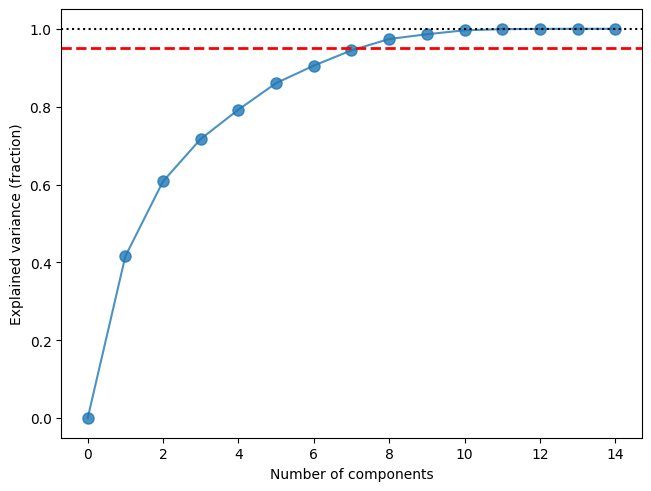

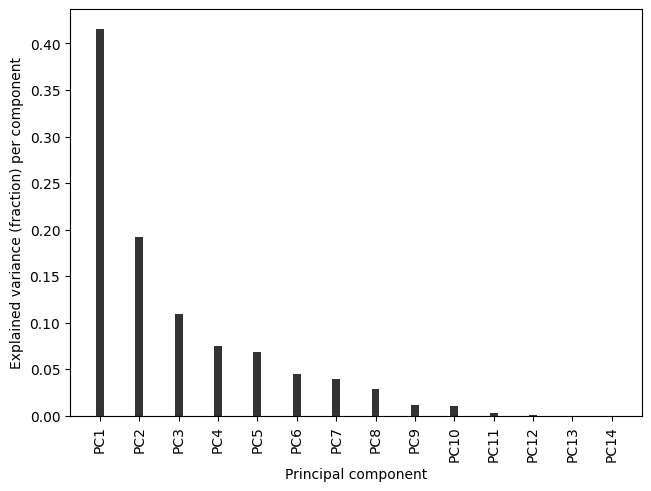

In [76]:

_, ax = pca_explained_variance(model,  marker='o', markersize=8, alpha=0.8)

# Let's add a line at an explained variance of 90%
ax.axhline(y=0.95, color='r', linestyle='--', linewidth=2)

plt.show()

pca_explained_variance_bar(
    model,
    width=0.2,
    alpha=0.8,
    color='black',
)

plt.show()

In [67]:

transformed_users_df.describe()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14
count,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06,2.145179e+06
mean,6.460265e-17,-5.999196e-17,3.815743e-18,-3.084392e-17,-2.358341e-17,-1.132799e-17,-5.776611e-17,-4.642488e-17,-2.376228e-17,-1.253366e-17,-1.528616e-18,-6.350298e-17,1.076159e-17,7.561646e-18
std,2.413003e+00,1.641302e+00,1.234800e+00,1.025759e+00,9.770752e-01,7.925243e-01,7.415647e-01,6.380454e-01,4.129536e-01,3.772618e-01,2.044004e-01,9.368874e-02,5.857317e-02,4.542851e-15
min,-4.055805e-01,-8.087405e+00,-1.144424e+01,-5.625673e+01,-3.488848e+01,-2.254886e+01,-2.401789e+01,-6.196273e+00,-2.737687e+01,-4.614771e+00,-2.024511e+01,-1.924586e+00,-1.315831e+00,-1.690576e-13
25%,-4.055805e-01,-2.099929e-01,-9.156465e-02,-6.104702e-02,-1.837875e-01,9.985953e-03,-5.839153e-02,-7.478939e-02,2.389049e-02,1.886011e-03,8.899848e-04,-1.148129e-03,5.611015e-04,6.403129e-17
50%,-3.985391e-01,-2.083200e-01,-8.977365e-02,-6.104702e-02,-1.837409e-01,9.985953e-03,-5.839153e-02,-7.478939e-02,2.389049e-02,3.298688e-03,8.899848e-04,-7.929974e-04,1.464764e-03,9.178686e-17
75%,-3.692249e-01,-2.083200e-01,-8.977365e-02,-6.017993e-02,-1.820885e-01,1.332277e-02,-5.208546e-02,-4.686432e-02,2.418256e-02,3.298688e-03,1.300751e-03,-7.929974e-04,1.464764e-03,9.178686e-17
max,4.598529e+01,7.453036e+01,6.203549e+01,1.674896e+02,1.995955e+02,6.801901e+01,1.210096e+01,1.081499e+01,9.790939e+01,5.188351e+00,8.341222e+01,3.613872e+00,1.295613e+00,9.924352e-14


In [68]:
components_df = pd.DataFrame(model.components_, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())

components_df['magnitude'] = components_df.apply(lambda row: np.sqrt(np.sum(row**2)), axis=1)

components_df.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction,magnitude
PC1,0.395177,0.392710,0.399347,0.396444,0.217088,0.162271,0.053562,0.333027,0.075560,0.099569,0.025305,0.071862,0.100420,0.392710,1.0
PC2,-0.073826,-0.079423,-0.092346,-0.089689,0.001206,0.014748,0.040295,-0.040022,0.485161,0.505715,0.081166,0.464246,0.498674,-0.079423,1.0
PC3,-0.120474,-0.146254,-0.032454,-0.022568,0.477602,0.553214,0.624789,-0.086494,-0.014230,-0.057620,0.036476,-0.023511,-0.061207,-0.146254,1.0


In [69]:
loadings = components_df.drop('magnitude', axis=1).mul(np.sqrt(model.explained_variance_), axis=0)

loadings_df = pd.DataFrame(loadings, index=[f'PC{i+1}' for i in range(len(model.components_))], columns=normalized_users_df.columns.tolist())


In [70]:
loadings_df.head(3)

,total_addtocart,total_transaction,total_view,unique_items,avg_time_view_to_addtocart,avg_time_addtocart_to_transaction,avg_time_between_transactions,avg_interactions_per_week,addtocart,transaction,view,p_addtocart_given_view,p_transaction_given_addtocart,avg_items_per_transaction
PC1,0.953562,0.947611,0.963626,0.956622,0.523833,0.391560,0.129245,0.803595,0.182326,0.240260,0.061061,0.173403,0.242315,0.947611
PC2,-0.121170,-0.130358,-0.151568,-0.147206,0.001980,0.024206,0.066136,-0.065688,0.796296,0.830031,0.133217,0.761969,0.818475,-0.130358
PC3,-0.148761,-0.180595,-0.040075,-0.027866,0.589742,0.683108,0.771489,-0.106802,-0.017571,-0.071149,0.045041,-0.029031,-0.075578,-0.180595


In [71]:


# Apply PCA with 5 components
pca_7 = PCA(n_components=7)
transformed_users_7pc = pca_7.fit_transform(normalized_users)

# Reconstruct data
reconstructed_data = pca_7.inverse_transform(transformed_users_7pc)

# Compute Reconstruction Error (Euclidean distance)
reconstruction_error = np.linalg.norm(normalized_users - reconstructed_data, axis=1)

# Compute Mean and Standard Deviation
mean_error = np.mean(reconstruction_error)
std_error = np.std(reconstruction_error)

# Identify Outliers (Error > 3 Standard Deviations)
threshold = mean_error + 3 * std_error

# Convert transformed data back to DataFrame
transformed_users_7pc = pd.DataFrame(transformed_users_7pc, columns=[f'PC{i+1}' for i in range(7)])
transformed_users_7pc['pca_outlier'] = (reconstruction_error > threshold).astype(int)
# Copy the 'pca_outlier' column from transformed_users_5pc to transformed_users_df
transformed_users_df['pca_outlier'] = transformed_users_7pc['pca_outlier']



In [92]:
#Need to take a sample because plotly taking too much time
transformed_users_df_sampled = transformed_users_df.sample(n=100000, random_state=142)  # Adjust the number as needed

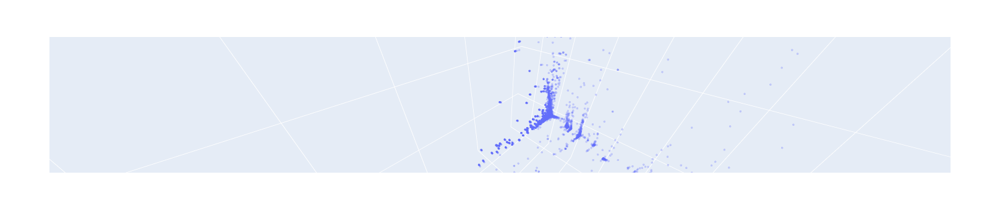

In [93]:

transformed_users_df = transformed_users_df.astype('float32')


# Create a 3D scatter plot
fig = px.scatter_3d( #scatter_3d scatter
    transformed_users_df_sampled,
    x="PC1",  # First principal component
    y="PC2",  # Second principal component
    z="PC3",  # Third principal component
)

fig.update_traces(
    marker=dict(
        size=2,  # Smaller marker size
        opacity=0.3  # Transparency (alpha)
    )
)

# Show the plot
fig.show()

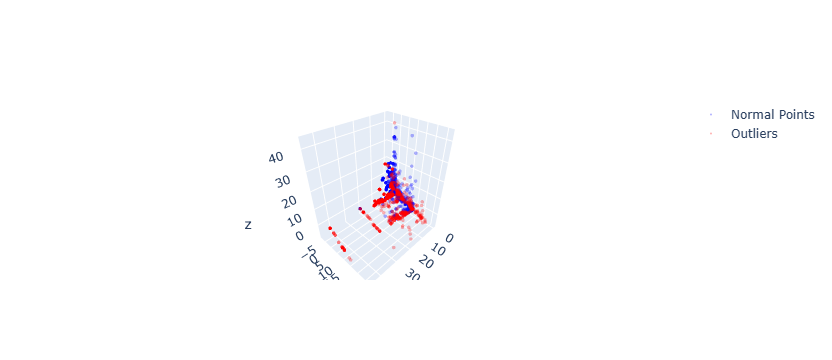

In [94]:


# Separate outliers in the sampled data
sampled_outliers = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 1]
sampled_normal_data = transformed_users_df_sampled[transformed_users_df_sampled["pca_outlier"] == 0]

# Create a 3D scatter plot
fig = go.Figure()

# Add normal points (blue)
fig.add_trace(
    go.Scatter3d(
        x=sampled_normal_data["PC1"],
        y=sampled_normal_data["PC2"],
        z=sampled_normal_data["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="blue"),
        name="Normal Points",
    )
)

# Add outliers (red)
fig.add_trace(
    go.Scatter3d(
        x=sampled_outliers["PC1"],
        y=sampled_outliers["PC2"],
        z=sampled_outliers["PC3"],
        mode="markers",
        marker=dict(size=2, opacity=0.3, color="red"),
        name="Outliers",
    )
)

# Show the plot
fig.show()


In [95]:
pca_outliers = transformed_users_df[transformed_users_df["pca_outlier"] == 1]

In [96]:
pca_outliers.shape[0]

44801

In [97]:
pca_outliers.describe()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,pca_outlier
count,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,44801.000000,4.480100e+04,44801.0
mean,10.521233,0.681460,0.273089,0.149541,0.456831,-0.461637,1.226241,1.685215,0.320552,-0.057798,0.146098,-0.004947,-0.030421,-2.980238e-16,1.0
std,10.585010,6.281425,4.501762,3.752673,4.079376,2.871795,3.922164,3.735649,2.232985,2.296430,1.301902,0.532946,0.335938,2.630495e-14,0.0
min,0.324149,-8.087405,-11.444238,-56.256729,-34.888477,-22.548857,-24.017893,-6.196272,-27.376873,-4.614771,-20.245110,-1.924586,-1.315831,-1.690576e-13,1.0
25%,3.409853,-2.076622,-1.632115,-0.305985,-0.096268,-0.924276,-0.458529,-0.973069,-0.049463,-1.761306,0.013147,-0.228930,-0.238097,-8.641798e-15,1.0
50%,7.745003,-1.159274,-0.524947,-0.100963,-0.018795,0.225075,0.828935,1.943548,0.079969,-0.250685,0.025572,0.001691,0.045313,-2.507445e-16,1.0
75%,11.997291,-0.203507,0.996253,0.327589,0.571642,0.882549,2.174681,4.096130,0.167531,1.184747,0.038112,0.141341,0.233625,5.410222e-15,1.0
max,45.985294,74.530357,62.035492,167.489639,199.595505,67.634117,12.100963,10.814988,97.909393,5.188352,83.412224,3.613872,0.884914,9.924352e-14,1.0
